In [84]:
from pathlib import Path

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.offline
from plotly.subplots import make_subplots
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler

from pptoolbox.platform import preprocess, WAVELENGTHS_3NM_V1
from pptoolbox.preprocessing import SNV, MSC, SavitzkyGolay, Detrend
from pptoolbox.visualization import (plot_spectra, plot_loadings, plot_scree, fit_pca,
                                               generate_pc_df, plot_svp, initialize_theme,spectral_vector_properties)

from sklearn.feature_selection import f_classif, mutual_info_classif, chi2

plotly.offline.init_notebook_mode()
qualitative_cmap, diverging_cmap, light_cmap = initialize_theme()

# import data

In [85]:
datafolder_path = Path ("../data/")
raw_folder_path = datafolder_path / "raw"
raw_csv = raw_folder_path / "spectra_241202.csv"
raw_df = pd.read_csv(raw_csv)

label_csv = datafolder_path / "processed/label.csv"
label_df = pd.read_csv(label_csv)

raw_df.shape,label_df.shape


((2316, 13), (507, 10))

In [86]:
raw_df.head(20)

,lot_id,specimen_id,lot_name,date_scanned,analyser_id,company_id,product_id,product_name,raw_data,dark_ref_data,white_ref_data,dark_ref_scan_time,white_ref_scan_time
0,77121,462881,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889439,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
1,77121,462882,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889480,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
2,77121,462883,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889526,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
3,77121,462885,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889562,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
4,77122,462837,Dwarf Set_FarmA_September2024_Sample-2_5pct Dw...,1725888182,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
5,77122,462839,Dwarf Set_FarmA_September2024_Sample-2_5pct Dw...,1725888232,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
6,77122,462840,Dwarf Set_FarmA_September2024_Sample-2_5pct Dw...,1725888269,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
7,77122,462841,Dwarf Set_FarmA_September2024_Sample-2_5pct Dw...,1725888341,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
8,77123,462828,Dwarf Set_FarmA_September2024_Sample-3_10pct D...,1725887948,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
9,77123,462829,Dwarf Set_FarmA_September2024_Sample-3_10pct D...,1725887985,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299


In [87]:
raw_df.head()

,lot_id,specimen_id,lot_name,date_scanned,analyser_id,company_id,product_id,product_name,raw_data,dark_ref_data,white_ref_data,dark_ref_scan_time,white_ref_scan_time
0,77121,462881,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889439,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
1,77121,462882,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889480,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
2,77121,462883,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889526,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
3,77121,462885,Dwarf Set_FarmA_September2024_Sample-1_0pct Dw...,1725889562,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299
4,77122,462837,Dwarf Set_FarmA_September2024_Sample-2_5pct Dw...,1725888182,74,1269,6566,Palm Sugar,"[{""wavelength"": 335.3865051269531, ""reflectanc...","[159.37822916666667, 173.49901041666666, 167.9...","[159.9475, 173.36333333333334, 168.48109375, 1...",1725885269,1725885299


In [88]:
label_df.head()

,lot_id,scan_date,scan_month_year,white_ref_date,label,pct,ABOVE_BELOW_5pct_Dwarf,Farm,Preservative,Dwarf_Presence
0,77121,2024-09-09,2024-09,1725885299,September2024,0,0-5PCT,PNG,Chalk,Absent
1,77122,2024-09-09,2024-09,1725885299,September2024,5,0-5PCT,PNG,Chalk,Present
2,77123,2024-09-09,2024-09,1725885299,September2024,10,ABOVE 5PCT,PNG,Chalk,Present
3,77124,2024-09-10,2024-09,1725942151,September2024,15,ABOVE 5PCT,PNG,Chalk,Present
4,77126,2024-09-10,2024-09,1725942151,September2024,0,0-5PCT,PNG,Sulfite,Absent


In [89]:

label_df["white_ref_date"] = label_df["white_ref_date"].astype(str)
label_df['farm-month'] = label_df['Farm'] + "-" + label_df['scan_month_year']

# preprocess lots

In [90]:
raw_df, label_df = preprocess(raw_df, label_df, wavelengths=WAVELENGTHS_3NM_V1)

raw_df.shape, label_df.shape

((2028, 191), (2028, 10))

In [91]:
label_df = label_df[[
    'Preservative',
    # 'label',
    # 'white_ref_date',
    'scan_month_year',
    'Farm',
    "pct",
    'Dwarf_Presence',
    'ABOVE_BELOW_5pct_Dwarf',
    # 'farm-month'
    ]]
label_type_list = ['clf']*len(label_df.columns)

param_label_map = dict(zip(label_df.columns, label_type_list))

#remove Preservative from dictionary
param_label_map.pop('Preservative')
param_label_map

{'scan_month_year': 'clf',
 'Farm': 'clf',
 'pct': 'clf',
 'Dwarf_Presence': 'clf',
 'ABOVE_BELOW_5pct_Dwarf': 'clf'}

# filter data

In [92]:
selections = [
    # 'Chalk',
    'Sulfite'
]

# Check for Outliers

In [93]:
cmap=sns.color_palette()

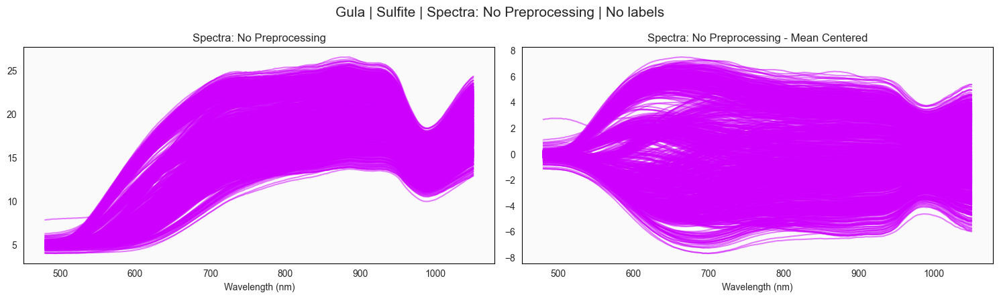

In [94]:
PREPROCESSING = 'No Preprocessing'

for selection in selections:

    mask = label_df['Preservative'] == selection
    selected_df = raw_df.loc[mask,:]
    SAMPLE_TYPE = f'Gula | {selection}'

    plot_spectra(selected_df, labels=None,
                spec_prep=PREPROCESSING,
                sample_type=SAMPLE_TYPE,
                cmap=cmap);

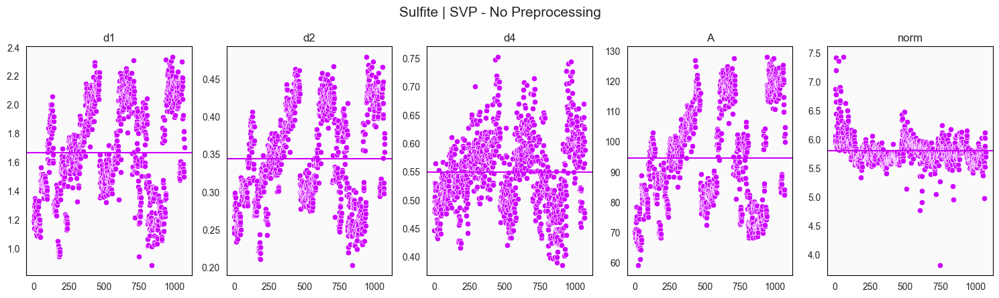

In [95]:
for selection in selections:
    mask = label_df['Preservative'] == selection
    selected_df = raw_df.loc[mask,:]
    SAMPLE_TYPE = f'Gula | {selection}'
    plot_svp(selected_df, title=f'{selection} | SVP - No Preprocessing')

## identify outlier samples

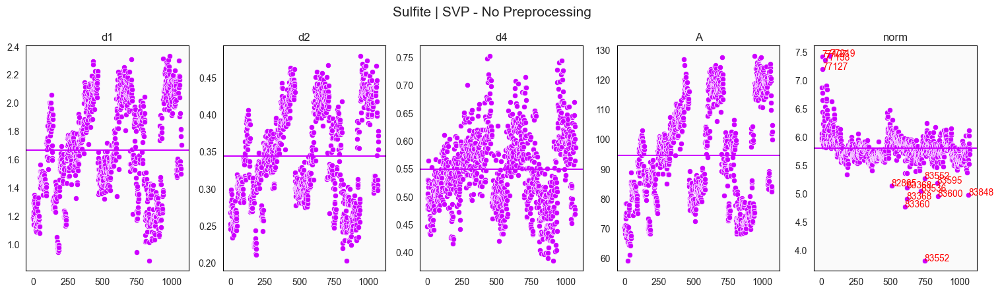

In [96]:
for selection in selections:

    mask = label_df['Preservative'] == selection
    selected_df = raw_df.loc[mask,:]

    plot_svp(selected_df, title=f'{selection} | SVP - No Preprocessing')

    svp_arr = spectral_vector_properties(selected_df, True)

    #metrics cutoff
    metrics = {
        0 : 'd1',
        1 : 'd2',
        2 : 'd4',
        3 : 'A',
        4 : 'norm'
    }
    choice = 4
    maxval = 7
    minval = 5.3

    norm_data = svp_arr[metrics[choice]]
    norm_ax = plt.gcf().axes[choice]

    for idx in range(len(norm_data)):
        if norm_data.iloc[idx] < minval or norm_data.iloc[idx] > maxval:  
            norm_ax.text(idx, norm_data.iloc[idx], norm_data.index[idx], 
                        fontsize=10, color='red')
            
    ### only for Chalk
    if selection == 'Chalk':
        norm_data = svp_arr[metrics[0]]
        norm_ax = plt.gcf().axes[0]
        for idx in range(len(norm_data)):
            if norm_data.iloc[idx] > 1.4:  
                norm_ax.text(idx, norm_data.iloc[idx], norm_data.index[idx], 
                            fontsize=10, color='red') 


    plt.draw()

Sulfite


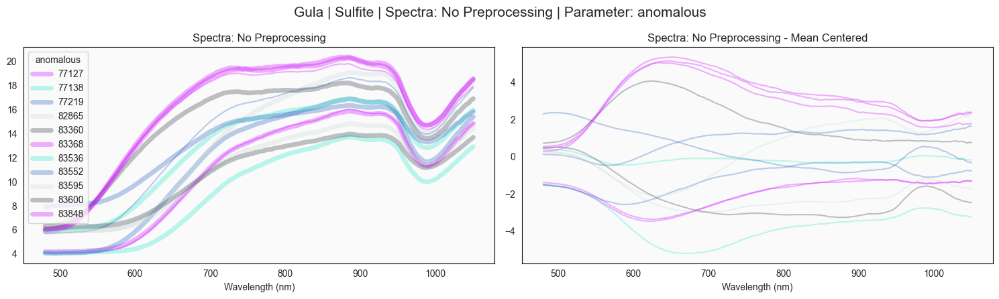

In [97]:
for selection in selections:
    print(selection)
    mask = label_df['Preservative'] == selection
    selected_df = raw_df.loc[mask,:]

    svp_arr = spectral_vector_properties(selected_df, True)

    anomalous_mask = (svp_arr[metrics[choice]] < minval) | (svp_arr[metrics[choice]] > maxval)

    if selection == 'Chalk':
        anomalous_mask = (svp_arr[metrics[choice]] < minval) | (svp_arr[metrics[choice]] > maxval) | (svp_arr[metrics[0]] > 1.4)

    anomalous_df = svp_arr.loc[anomalous_mask,:]

    check_df = selected_df.loc[anomalous_mask,:]

    check_df = check_df.reset_index()

    check_df_labels = check_df[['lot_id']]
    check_df_labels['anomalous'] = check_df['lot_id']
    check_df_labels= check_df_labels.set_index('lot_id')

    check_df = check_df.set_index('lot_id')

    SAMPLE_TYPE = f'Gula | {selection}'

    plot_spectra(check_df, labels=check_df_labels,
                spec_prep=PREPROCESSING,
                sample_type=SAMPLE_TYPE,
                cmap=cmap)

## filter outliers

In [98]:
cleaned_spectra = {}

for selection in selections:

    print(selection)
    mask = label_df['Preservative'] == selection
    selected_df = raw_df.loc[mask,:]
    selected_labels = label_df.loc[mask,:]
    print(selected_df.shape, selected_labels.shape)

    svp_arr = spectral_vector_properties(selected_df, True)

    if selection == 'Sulfite': #not removing outliers for Sulfite
        anomalous_mask = 0
        print(f'Number of anomalous specimens: {anomalous_mask}')
        cleaned_df = selected_df
        cleaned_labels = selected_labels
    elif selection == 'Chalk':
        anomalous_mask = (svp_arr[metrics[choice]] < minval) | (svp_arr[metrics[choice]] > maxval) | (svp_arr[metrics[0]] > 1.4)
        print(f'Number of anomalous specimens: {anomalous_mask.sum()}')
        cleaned_df = selected_df.loc[~anomalous_mask,:]
        cleaned_labels = selected_labels.loc[~anomalous_mask,:]

    cleaned_spectra  = {
        **cleaned_spectra,
        f'{selection}_spectra': cleaned_df,
        f'{selection}_label': cleaned_labels
    }

    output_dir = Path(f"../data/processed/{selection}")
    output_dir.mkdir(exist_ok=True, parents=True)
    cleaned_df.to_csv(output_dir/"cleaned_input.csv")
    cleaned_labels.to_csv(output_dir/"cleaned_label.csv")

print(cleaned_spectra.keys())

for key in cleaned_spectra.keys():
    print(key, cleaned_spectra[key].shape)    

Sulfite
(1072, 191) (1072, 6)
Number of anomalous specimens: 0
dict_keys(['Sulfite_spectra', 'Sulfite_label'])
Sulfite_spectra (1072, 191)
Sulfite_label (1072, 6)


Assigned Sulfite_spectra to spectra_df
Assigned Sulfite_label to label_df


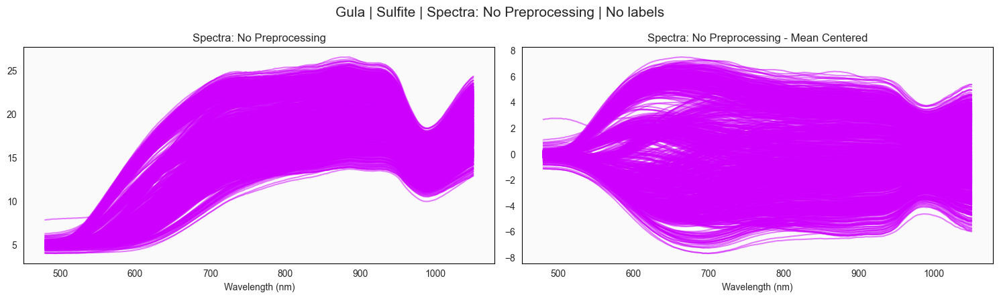

In [99]:
data_split = ['spectra', 'label']
PREPROCESSING = 'No Preprocessing'

for selection in selections:

    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')
    
    SAMPLE_TYPE = f'Gula | {selection}'

    plot_spectra(selected_df, labels=None,
                spec_prep=PREPROCESSING,
                sample_type=SAMPLE_TYPE,
                cmap=cmap);

# No Preprocessing

In [74]:
data_split = ['spectra', 'label']
spectra_meta = {}

Assigned Sulfite_spectra to spectra_df
Assigned Sulfite_label to label_df
(1072, 191) (1072, 5)


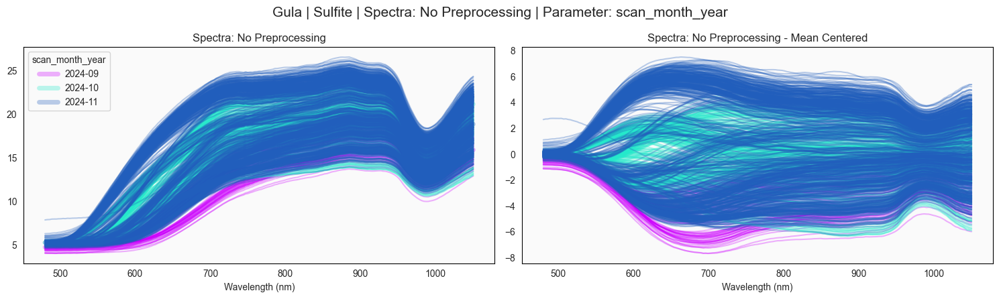

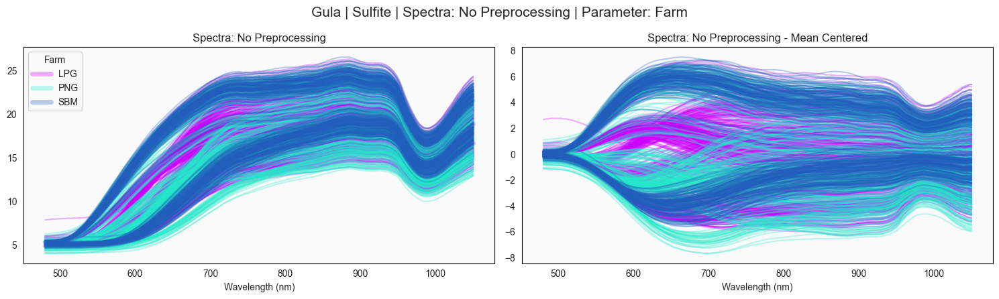

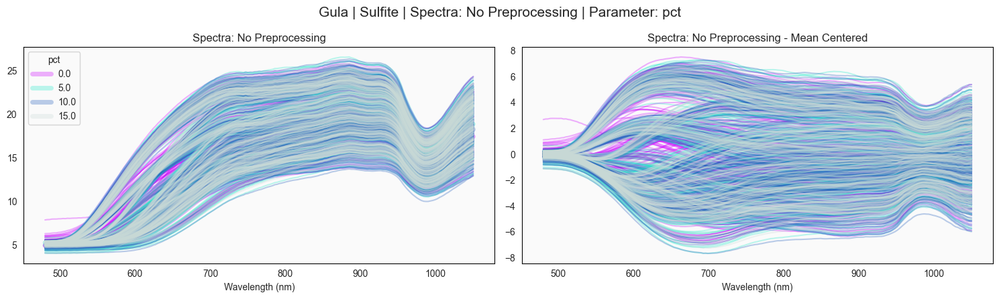

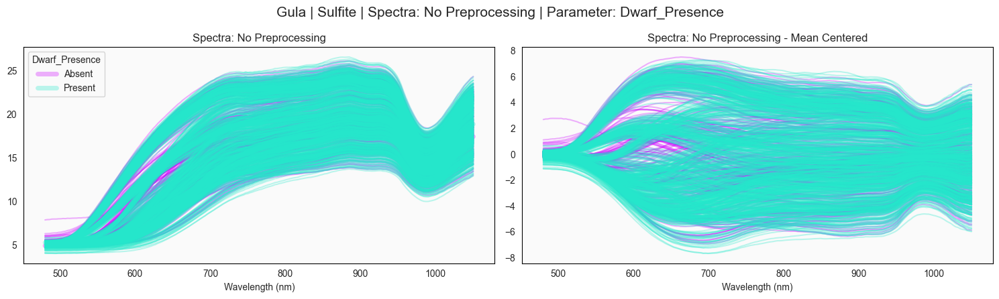

In [75]:
for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'

    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')
    
    print(selected_df.shape, selected_labels.shape)

    plot_df = selected_df.copy()

    spectra_meta = {
        **spectra_meta,
        f'{selection}_plot_df' : plot_df
    }

    for param, label_type in param_label_map.items():
        plot_spectra(plot_df, labels=selected_labels[[param]],
                    label_type=label_type,
                    spec_prep=PREPROCESSING,
                    sample_type=SAMPLE_TYPE,
                    cmap=cmap)

Total Explained Variance: 99.934% 
    Number of Components: 4


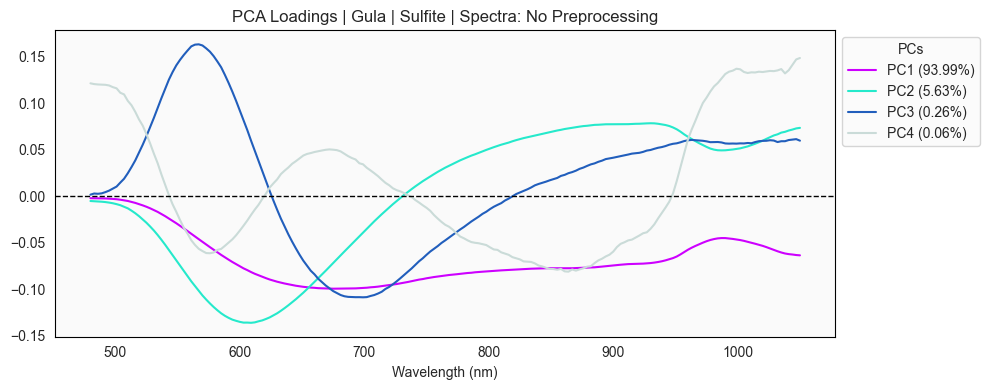

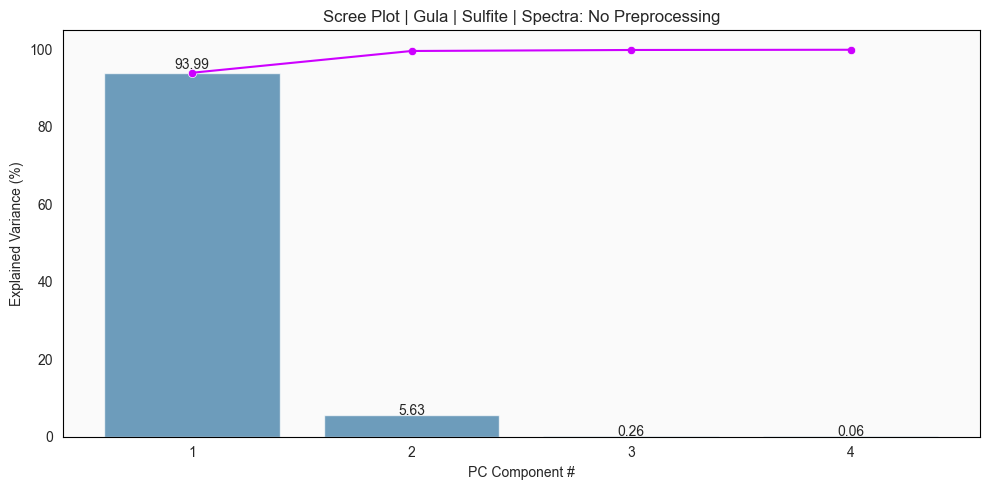

In [76]:
N_COMP = 0.999
RANDOM_STATE = 42

for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'

    plot_df = spectra_meta[f'{selection}_plot_df']

    fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)

    spectra_meta = {
        **spectra_meta,
        f'{selection}_fitted_pc' : fitted_pc,
        f'{selection}_pc_labels' : pc_labels,
        }

    fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
                            spec_prep=PREPROCESSING, 
                            sample_type=SAMPLE_TYPE)
    fig1, ax1 = plot_scree(fitted_pc,
                        spec_prep=PREPROCESSING, 
                        sample_type=SAMPLE_TYPE)
    print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
    Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

Assigned Sulfite_spectra to spectra_df
Assigned Sulfite_label to label_df
(1072, 191) (1072, 5)


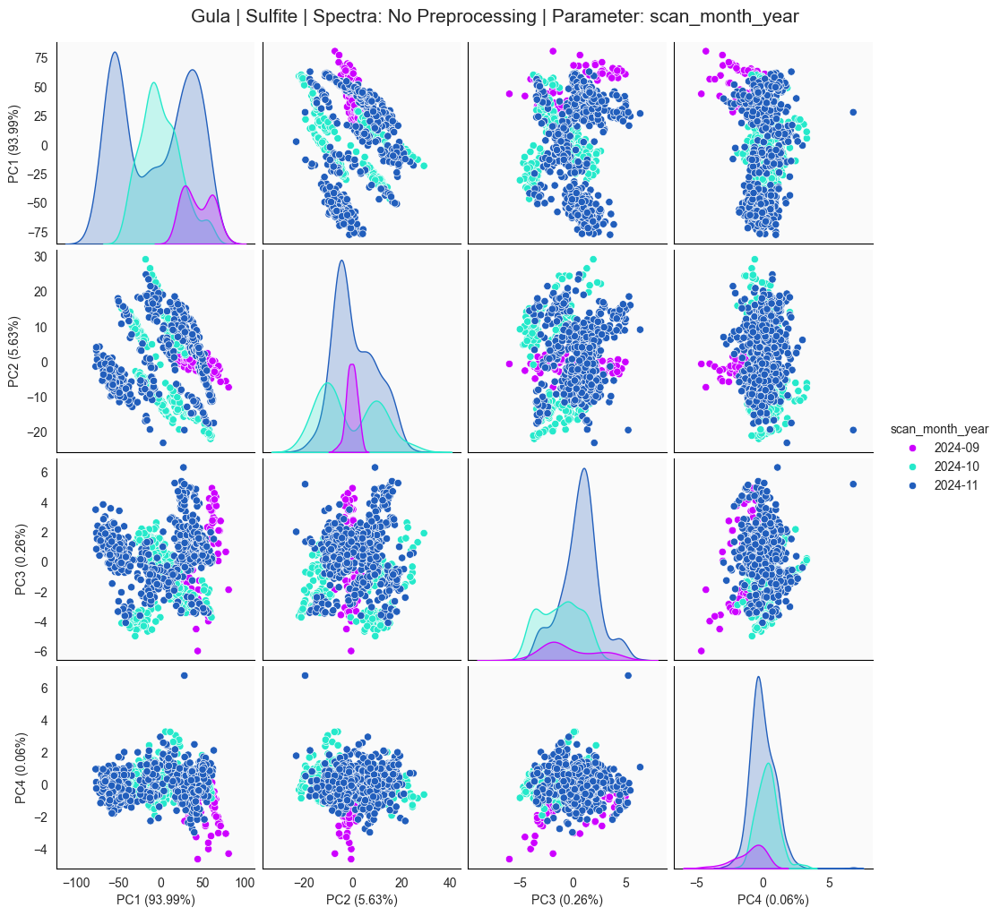

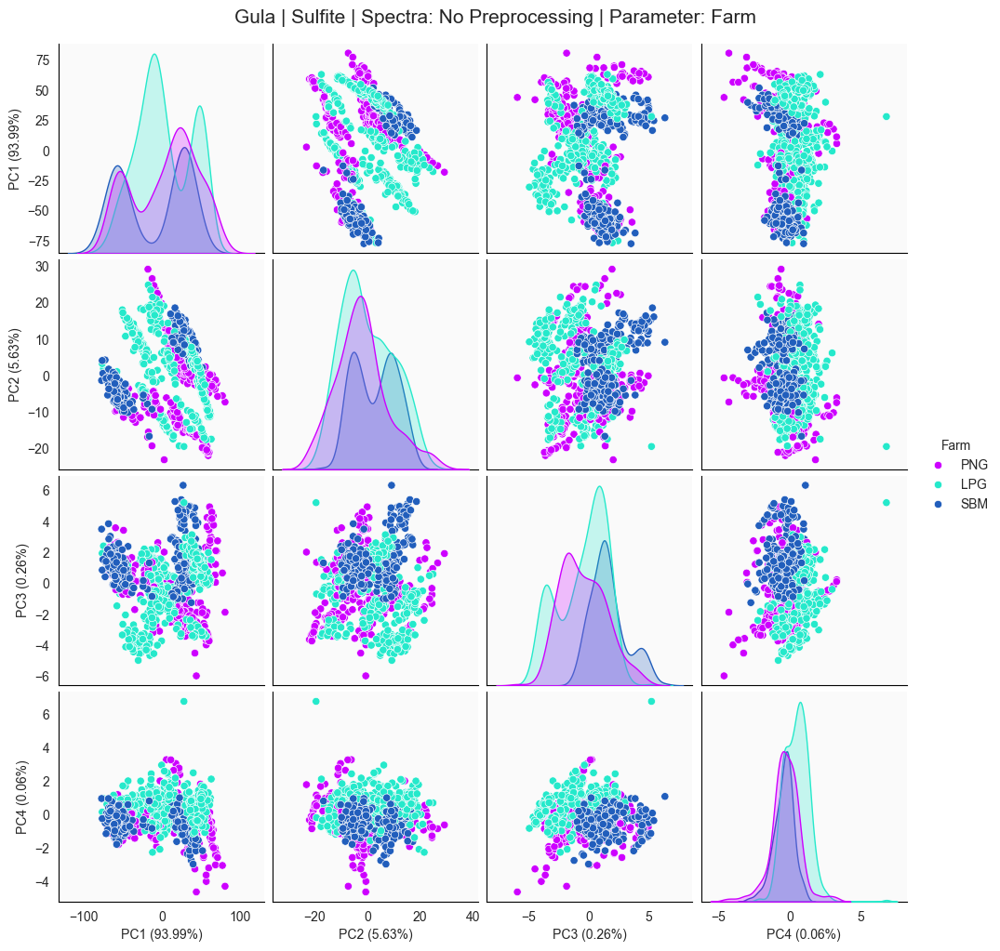

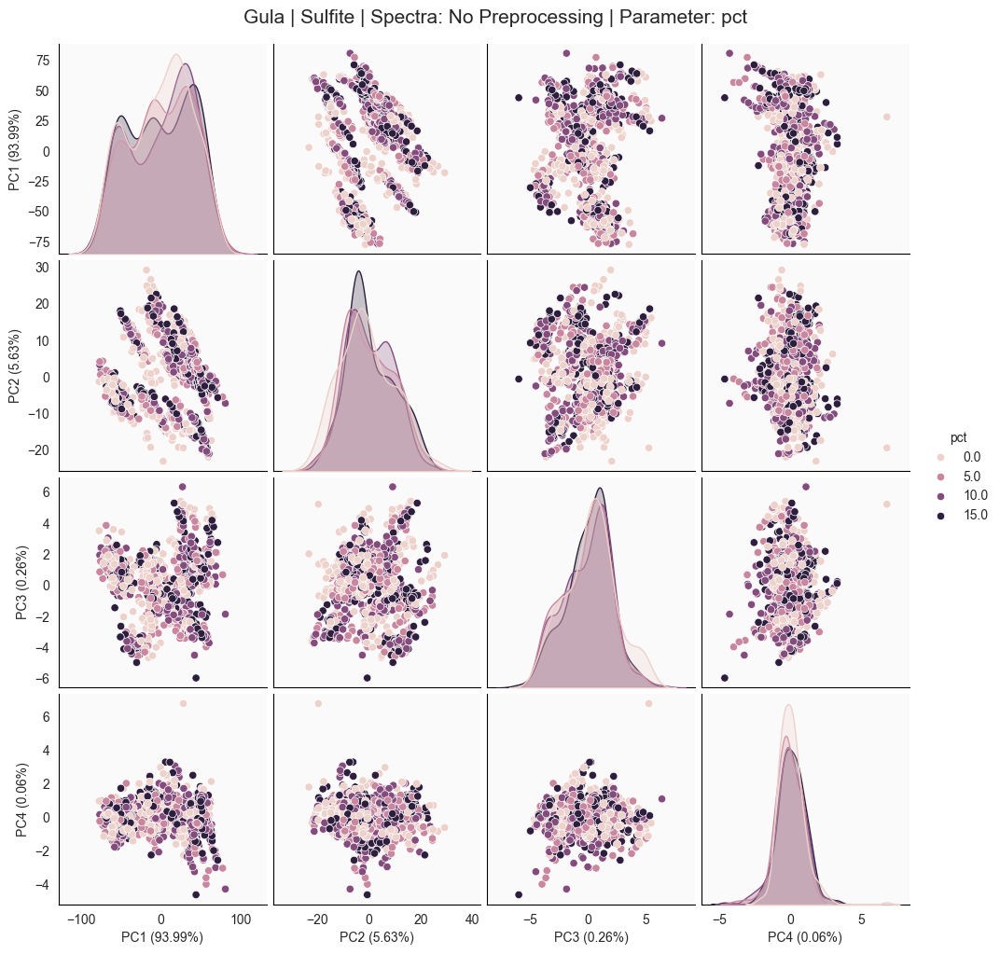

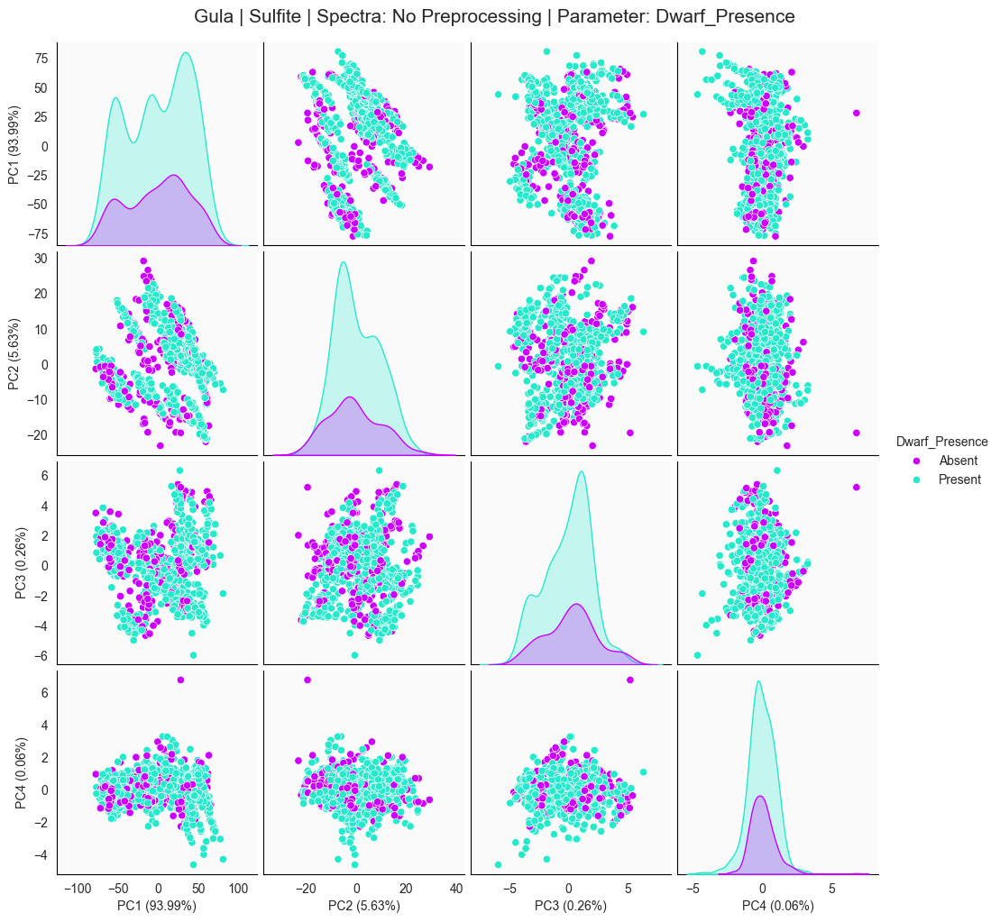

In [77]:
for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'
    
    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')
    
    plot_df = spectra_meta[f'{selection}_plot_df']
    fitted_pc = spectra_meta[f'{selection}_fitted_pc']
    pc_labels = spectra_meta[f'{selection}_pc_labels']

    print(plot_df.shape, selected_labels.shape)

    for param in param_label_map.keys():
        pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=selected_labels[[param]])
        sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
        plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [78]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()

# SNV

In [79]:
# CONFIGS
cmap=sns.color_palette()
PREPROCESSING = 'SNV'
spectra_meta = {}

Assigned Sulfite_spectra to spectra_df
Assigned Sulfite_label to label_df


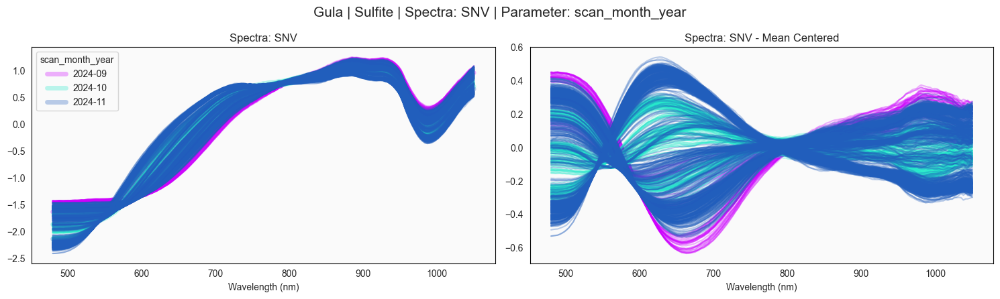

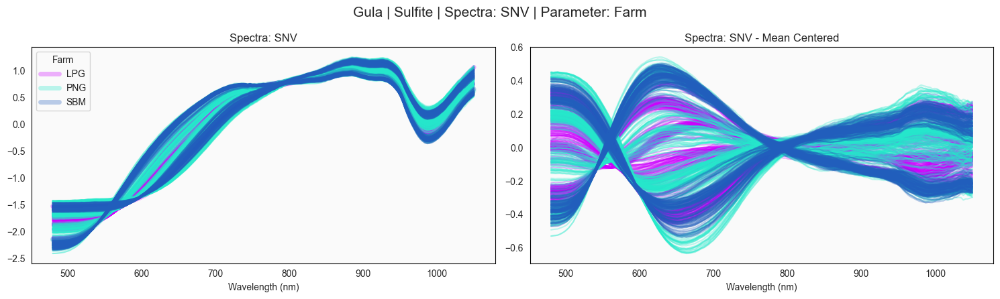

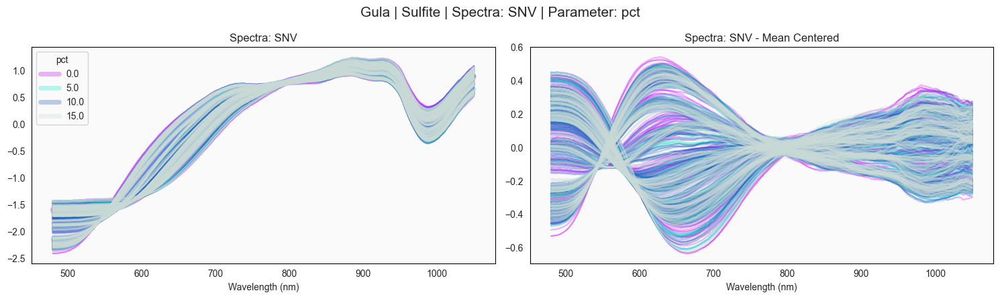

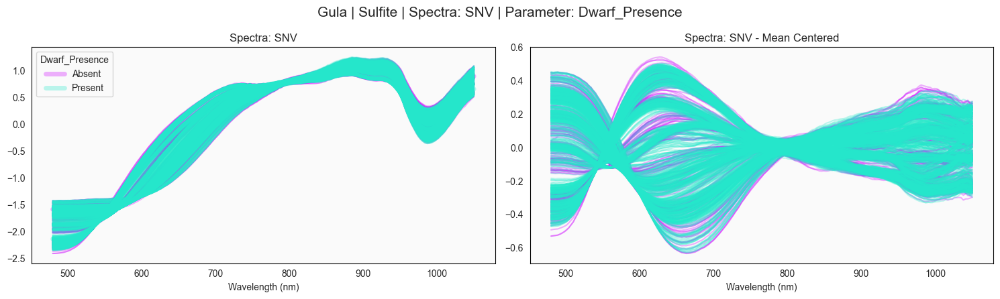

In [80]:
for selection in selections:

    SAMPLE_TYPE = f'Gula | {selection}'

    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')

    snv_df = pd.DataFrame(SNV().fit_transform(selected_df), columns=selected_df.columns, index=selected_df.index)
    plot_df = snv_df.copy()

    spectra_meta = {
        **spectra_meta,
        f'{selection}_plot_df' : plot_df
    }

    for param, label_type in param_label_map.items():
        plot_spectra(plot_df, labels=selected_labels[[param]],
                    label_type=label_type,
                    spec_prep=PREPROCESSING,
                    sample_type=SAMPLE_TYPE,
                    cmap=cmap)

Total Explained Variance: 99.597% 
    Number of Components: 3


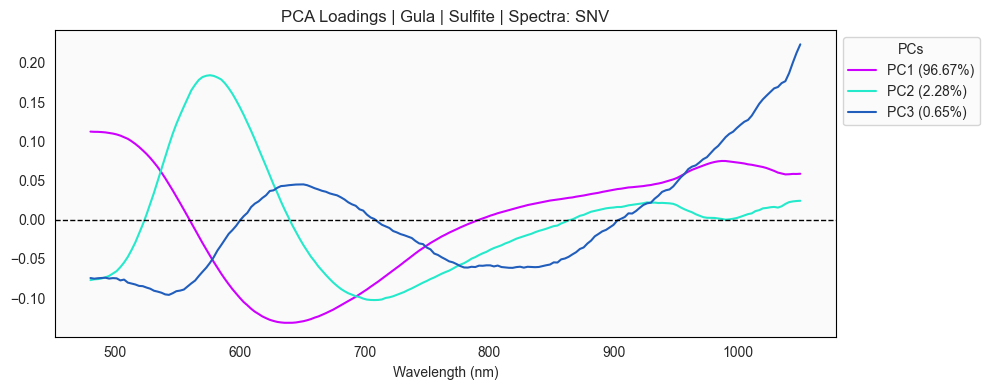

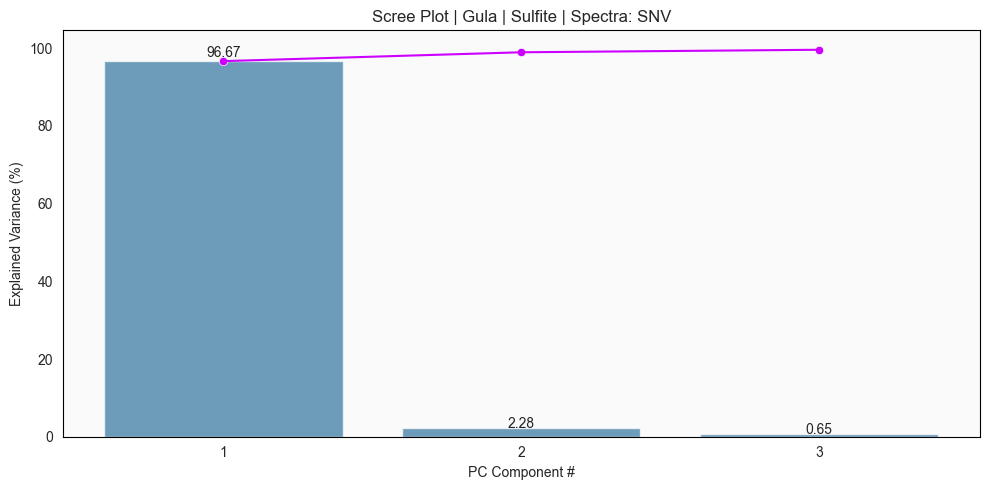

In [81]:
N_COMP = 0.99
RANDOM_STATE = 42

for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'

    plot_df = spectra_meta[f'{selection}_plot_df']

    fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)

    spectra_meta = {
        **spectra_meta,
        f'{selection}_fitted_pc' : fitted_pc,
        f'{selection}_pc_labels' : pc_labels,
        }

    fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
                            spec_prep=PREPROCESSING, 
                            sample_type=SAMPLE_TYPE)
    fig1, ax1 = plot_scree(fitted_pc,
                        spec_prep=PREPROCESSING, 
                        sample_type=SAMPLE_TYPE)
    print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
    Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

Assigned Sulfite_spectra to spectra_df
Assigned Sulfite_label to label_df
(1072, 191) (1072, 5)


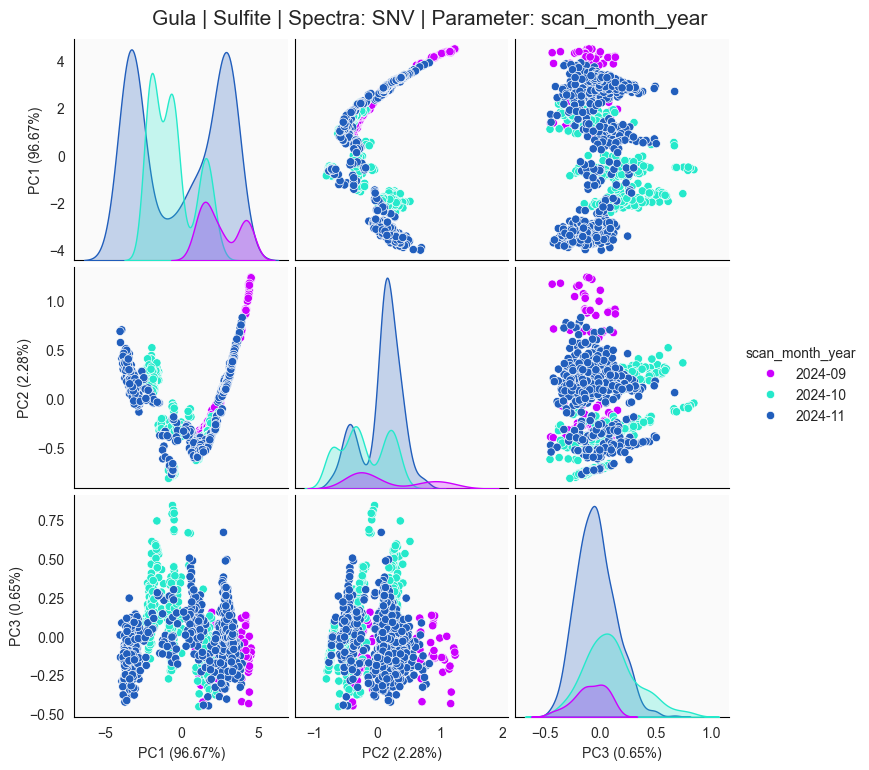

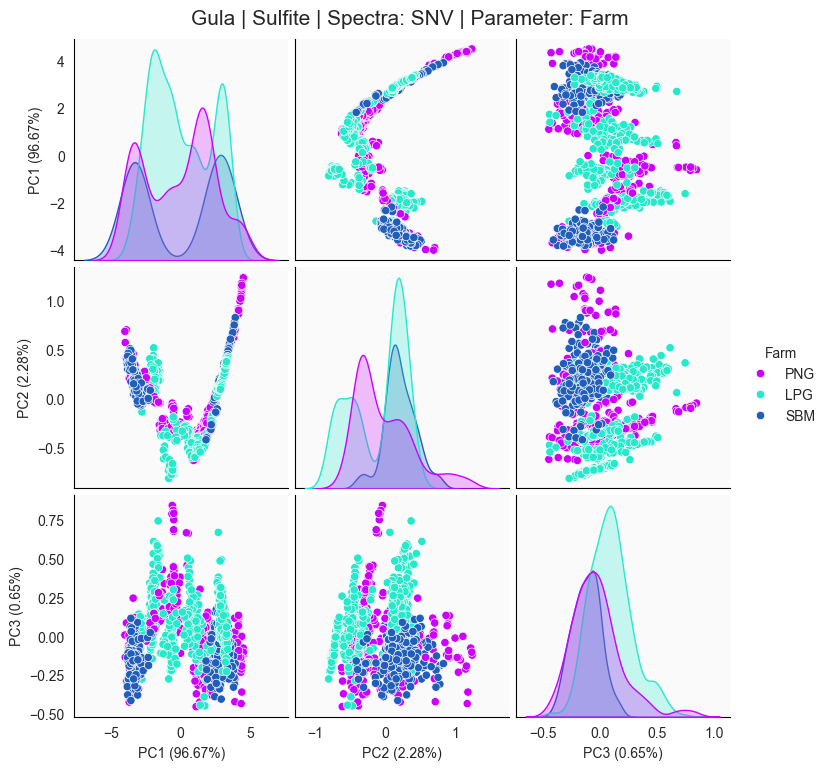

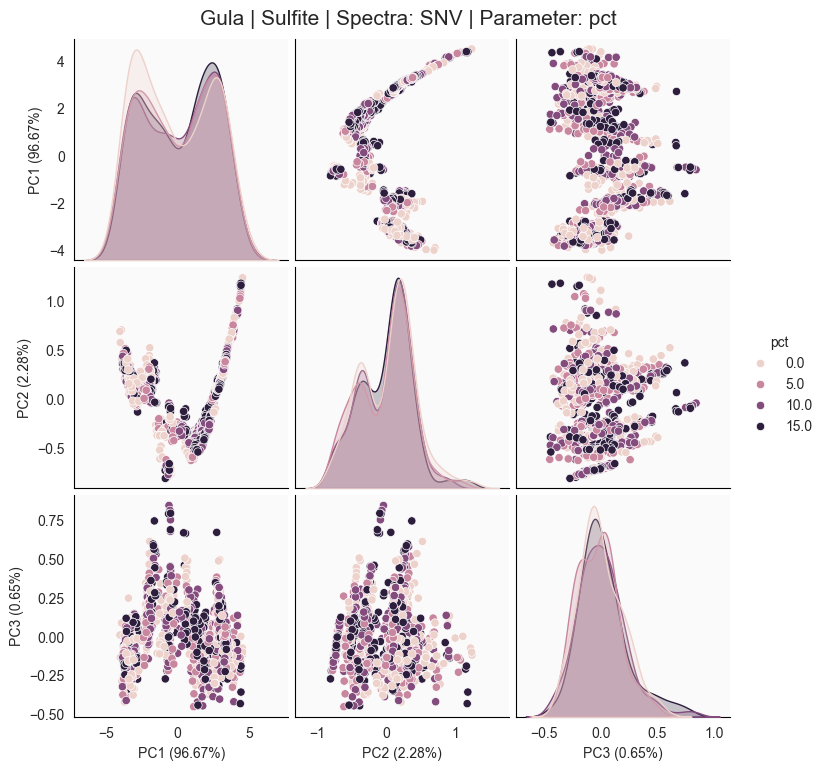

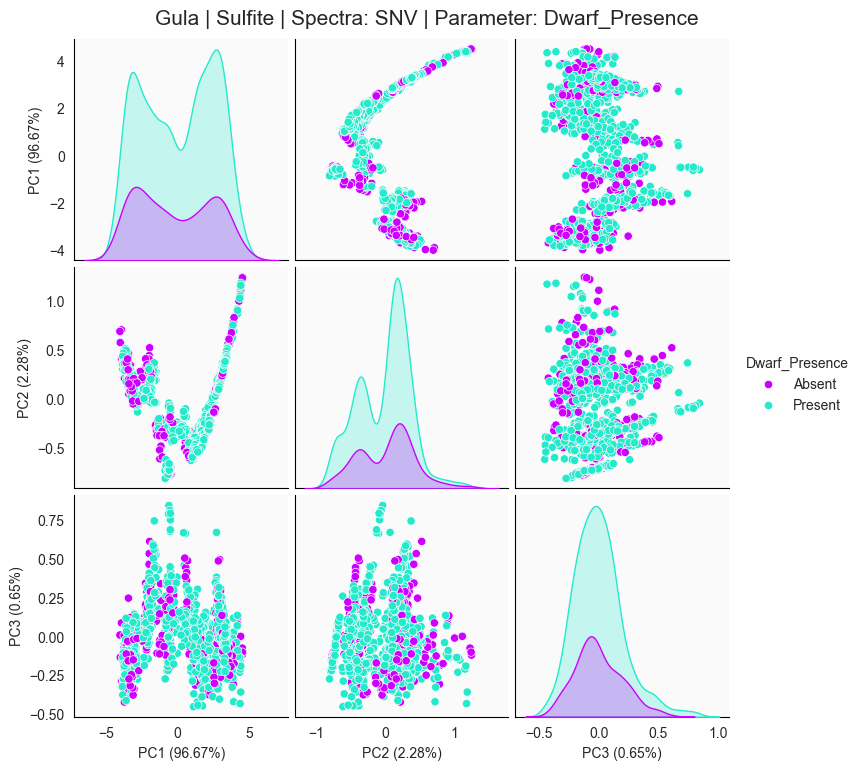

In [82]:
for selection in selections:

    SAMPLE_TYPE = f'Gula | {selection}'

    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')
    
    plot_df = spectra_meta[f'{selection}_plot_df']
    fitted_pc = spectra_meta[f'{selection}_fitted_pc']
    pc_labels = spectra_meta[f'{selection}_pc_labels']

    ### masking for investigation

    masking = [
        'no',
        # 'farm',
        # 'pct'
        ]

    if masking == ['no']:
        print(plot_df.shape, selected_labels.shape)

        for param in param_label_map.keys():
            pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=selected_labels[[param]])
            sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
            plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

    elif masking == ['farm']:

        farms = ['PNG', 'LPG', 'SBM']

        for farm in farms:
            mask = (selected_labels['Farm'] == farm)
            plot_df_mask = plot_df.loc[mask,:]
            selected_labels_mask = selected_labels.loc[mask,:]

            print(plot_df_mask.shape, selected_labels_mask.shape)

            for param in param_label_map.keys():
                pc_df = generate_pc_df(plot_df_mask, fitted_pc, pc_labels, labels=selected_labels_mask[[param]])
                sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
                plt.suptitle(f'{SAMPLE_TYPE} | {farm} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

    elif masking == ['pct']:

        mask = (selected_labels['pct'] == 0)
        plot_df_mask = plot_df.loc[mask,:]
        selected_labels_mask = selected_labels.loc[mask,:]

        print(plot_df_mask.shape, selected_labels_mask.shape)

        for param in param_label_map.keys():
            pc_df = generate_pc_df(plot_df_mask, fitted_pc, pc_labels, labels=selected_labels_mask[[param]])
            sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
            plt.suptitle(f'{SAMPLE_TYPE} | 0 pct | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [83]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()

# Detrend

In [33]:
# # CONFIGS
# msc = Detrend()
# msc_df = pd.DataFrame(msc.fit_transform(raw_df), columns=raw_df.columns, index=raw_df.index)
# plot_df = msc_df.copy()
# PREPROCESSING = 'Detrend'

In [34]:
# for param, label_type in param_label_map.items():
#     plot_spectra(plot_df, labels=label_df[[param]],
#                  label_type=label_type,
#                  spec_prep=PREPROCESSING,
#                  sample_type=SAMPLE_TYPE,
#                  cmap=cmap)

In [35]:
# N_COMP = 0.99
# RANDOM_STATE = 42

# fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)
# fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
#                           spec_prep=PREPROCESSING, 
#                           sample_type=SAMPLE_TYPE)
# fig1, ax1 = plot_scree(fitted_pc,
#                        spec_prep=PREPROCESSING, 
#                        sample_type=SAMPLE_TYPE)
# print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
# Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

In [36]:
# for param in param_label_map.keys():
#     pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df[[param]])
#     sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
#     plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [37]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()

# SNV-Detrend

In [38]:
# # CONFIGS
# snv_df = pd.DataFrame(Detrend().fit_transform(SNV().fit_transform(raw_df)), columns=raw_df.columns, index=raw_df.index)
# plot_df = snv_df.copy()
# PREPROCESSING = 'SNV-Detrend'

In [39]:
# for param, label_type in param_label_map.items():
#     plot_spectra(plot_df, labels=label_df[[param]],
#                  label_type=label_type,
#                  spec_prep=PREPROCESSING,
#                  sample_type=SAMPLE_TYPE,
#                  cmap=cmap)

In [40]:
# N_COMP = 0.99
# RANDOM_STATE = 42

# fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)
# fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
#                           spec_prep=PREPROCESSING, 
#                           sample_type=SAMPLE_TYPE)
# fig1, ax1 = plot_scree(fitted_pc,
#                        spec_prep=PREPROCESSING, 
#                        sample_type=SAMPLE_TYPE)
# print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
# Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

In [41]:
# for param in param_label_map.keys():
#     pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df[[param]])
#     sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
#     plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [42]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()

# SG1D9W2P

In [33]:
# CONFIGS
PREPROCESSING = 'SG1D9W2P'
spectra_meta = {}

Assigned Chalk_spectra to spectra_df
Assigned Chalk_label to label_df


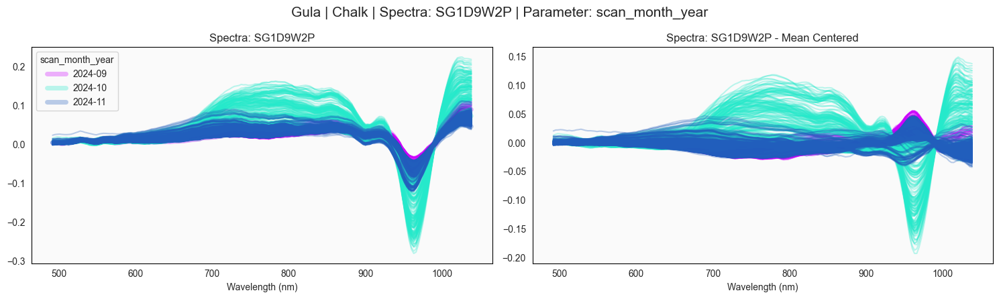

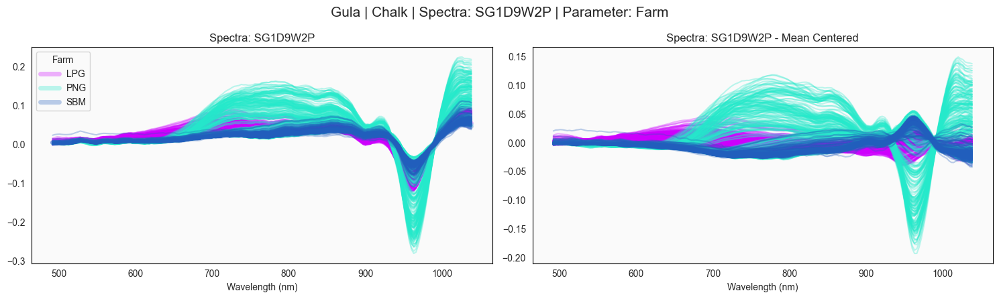

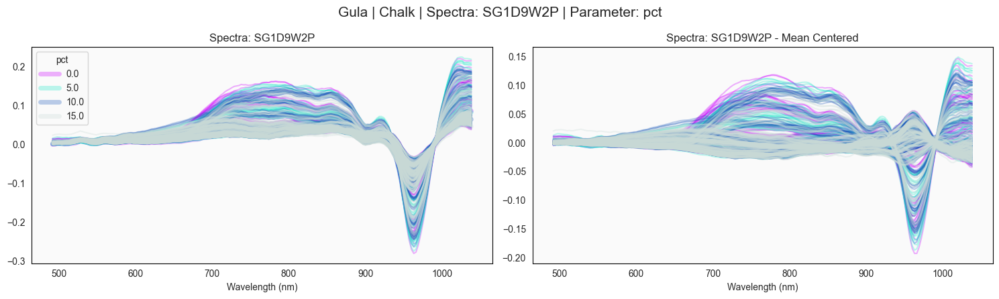

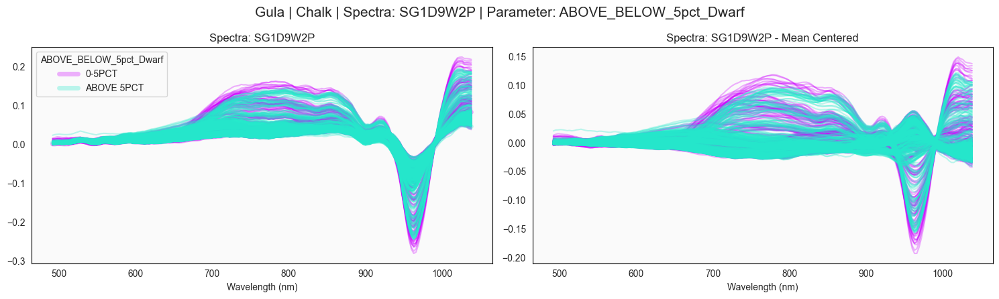

In [34]:
for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'
    
    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')

    msc = SavitzkyGolay(deriv=1, window=9, polyorder=2)
    msc_df = pd.DataFrame(msc.fit_transform(selected_df), 
                        columns=selected_df.columns[4:-4], index=selected_df.index)
    plot_df = msc_df.copy()

    spectra_meta = {
        **spectra_meta,
        f'{selection}_plot_df' : plot_df
    }

    for param, label_type in param_label_map.items():
        plot_spectra(plot_df, labels=selected_labels[[param]],
                    label_type=label_type,
                    spec_prep=PREPROCESSING,
                    sample_type=SAMPLE_TYPE,
                    cmap=cmap)

Total Explained Variance: 99.063% 
    Number of Components: 4


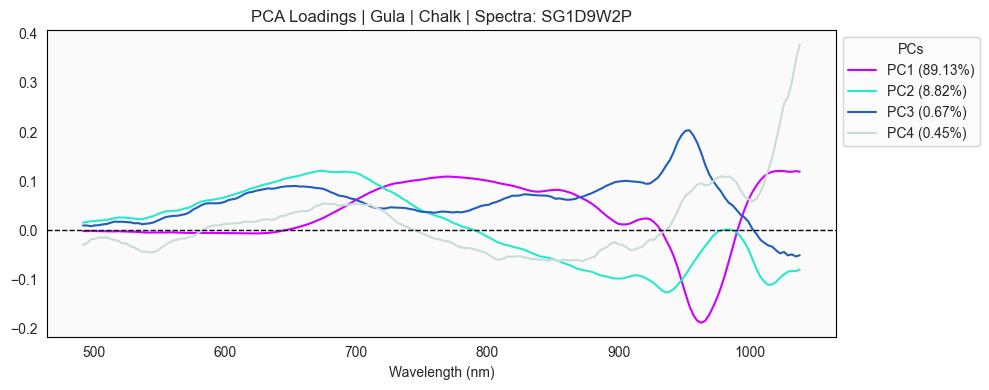

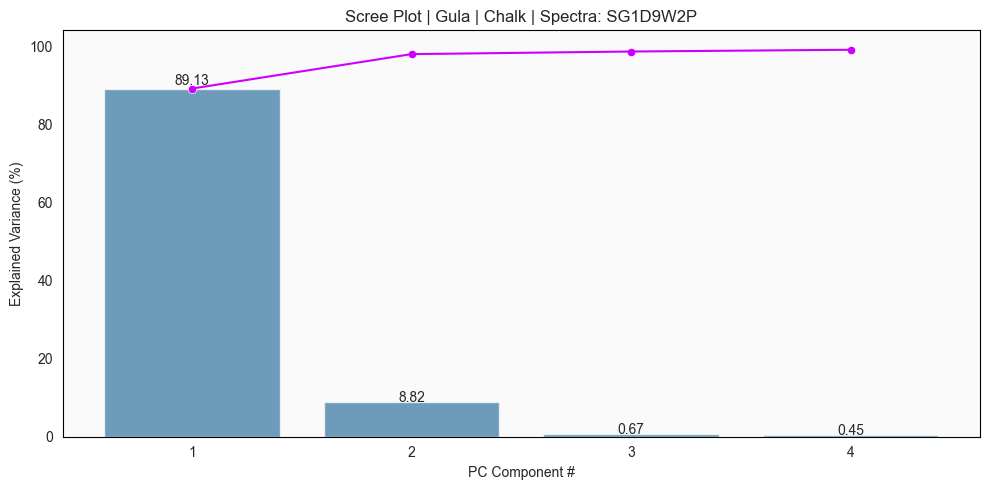

In [35]:
N_COMP = 0.99
RANDOM_STATE = 42

for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'

    plot_df = spectra_meta[f'{selection}_plot_df']

    fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)

    spectra_meta = {
        **spectra_meta,
        f'{selection}_fitted_pc' : fitted_pc,
        f'{selection}_pc_labels' : pc_labels,
        }

    fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
                            spec_prep=PREPROCESSING, 
                            sample_type=SAMPLE_TYPE)
    fig1, ax1 = plot_scree(fitted_pc,
                        spec_prep=PREPROCESSING, 
                        sample_type=SAMPLE_TYPE)
    print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
    Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

Assigned Chalk_spectra to spectra_df
Assigned Chalk_label to label_df
(943, 183) (943, 5)


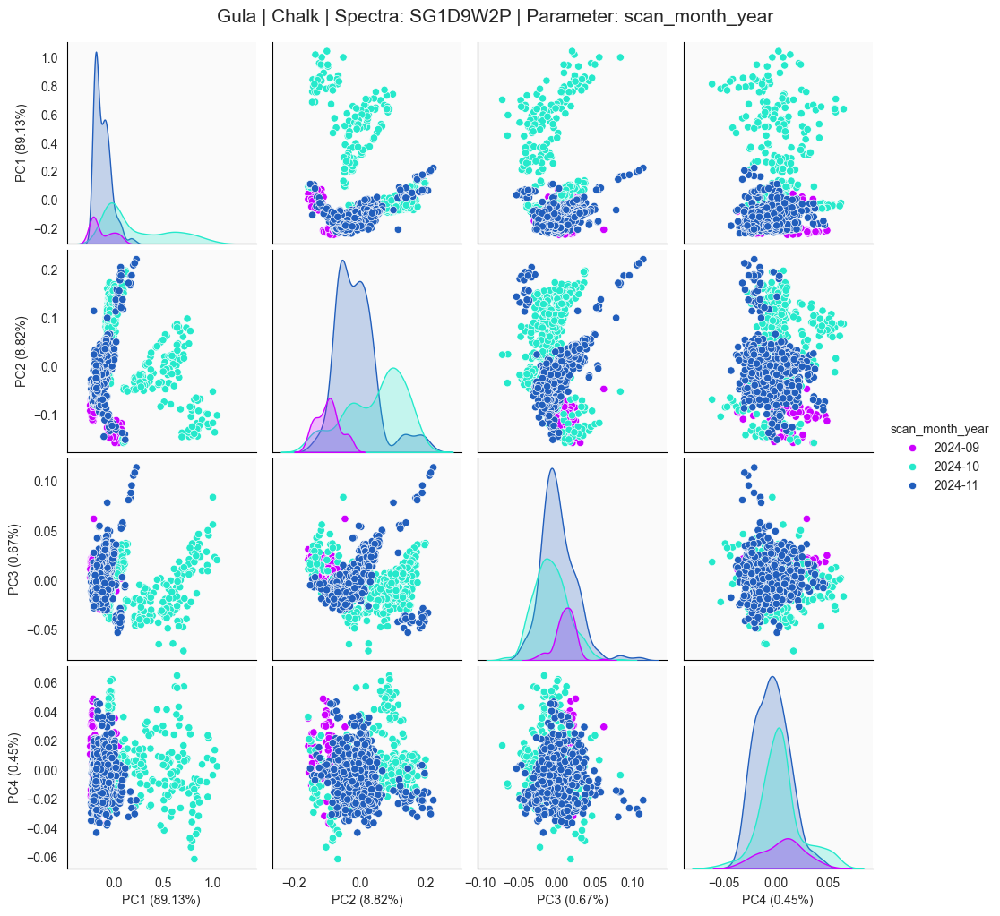

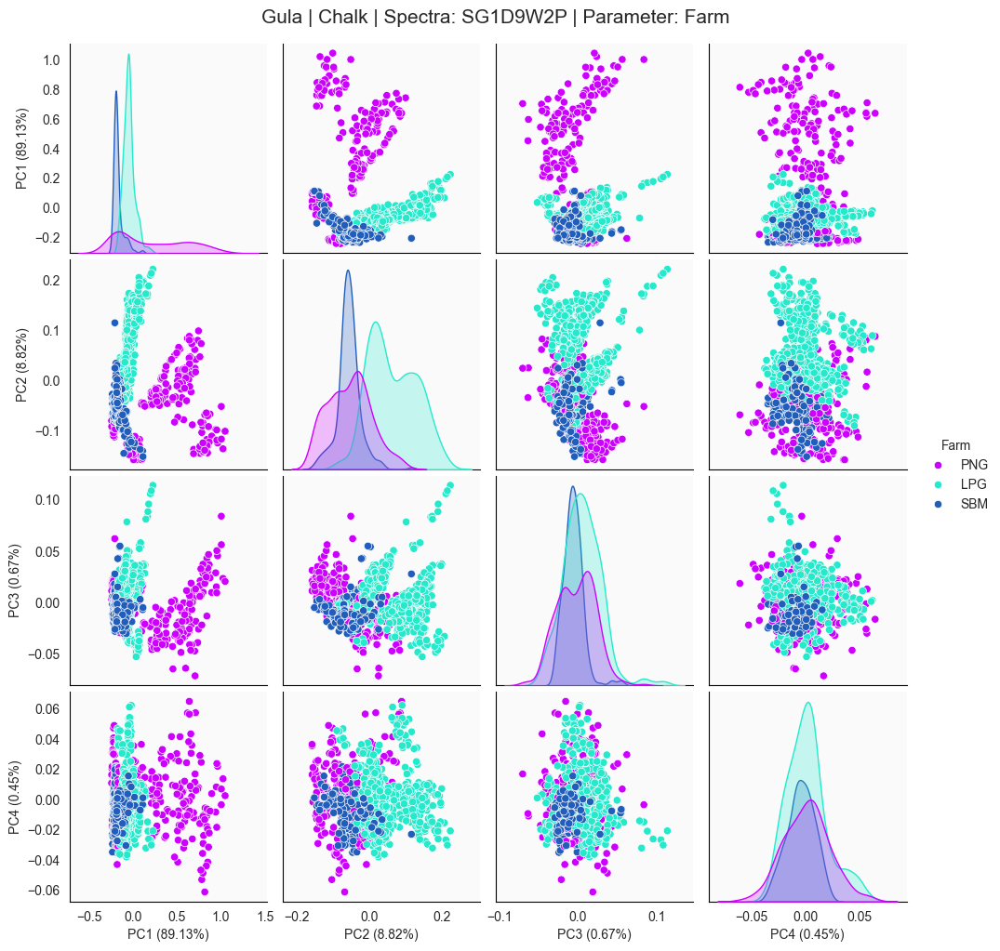

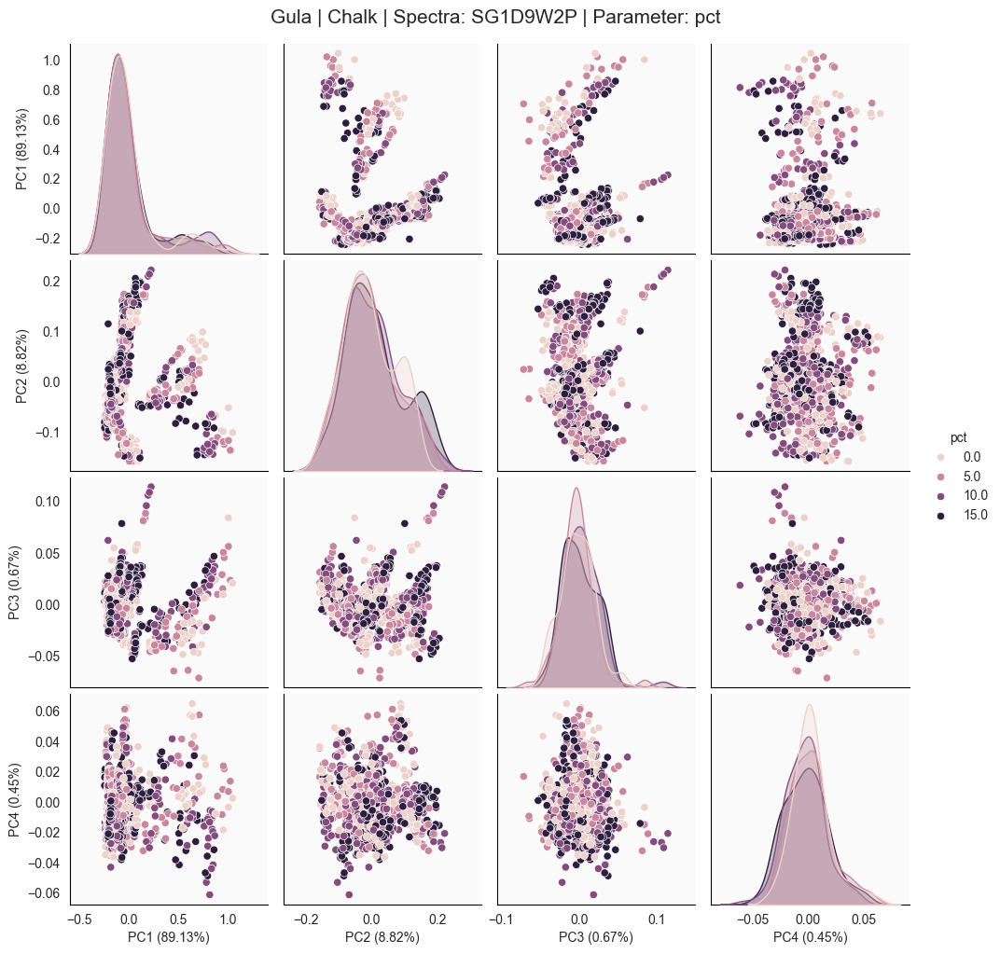

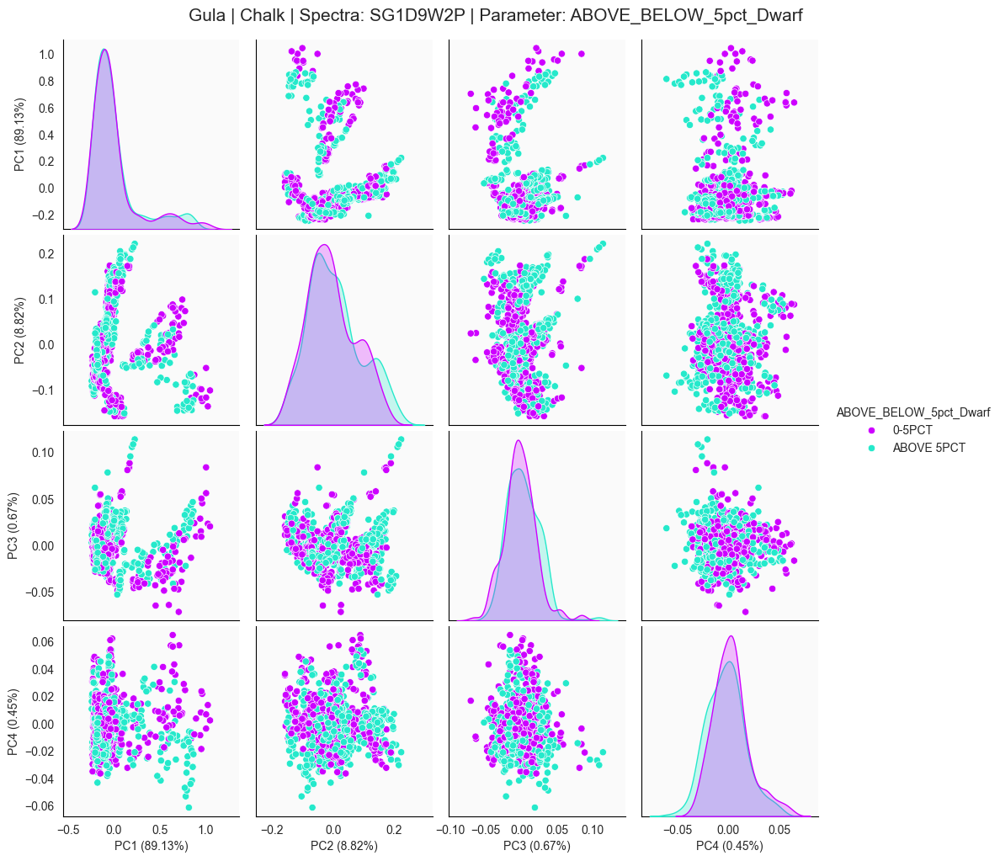

In [37]:
for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'

    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')
    
    plot_df = spectra_meta[f'{selection}_plot_df']
    fitted_pc = spectra_meta[f'{selection}_fitted_pc']
    pc_labels = spectra_meta[f'{selection}_pc_labels']

    ### masking for investigation

    masking = [
        'no',
        # 'farm',
        # 'pct'
        ]

    if masking==['no']:
        print(plot_df.shape, selected_labels.shape)

        for param in param_label_map.keys():
            pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=selected_labels[[param]])
            sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
            plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

    elif masking==['farm']:

        farms = ['PNG', 'LPG', 'SBM']

        for farm in farms:
            mask = (selected_labels['Farm'] == farm)
            plot_df_mask = plot_df.loc[mask,:]
            selected_labels_mask = selected_labels.loc[mask,:]

            print(plot_df_mask.shape, selected_labels_mask.shape)

            for param in param_label_map.keys():
                pc_df = generate_pc_df(plot_df_mask, fitted_pc, pc_labels, labels=selected_labels_mask[[param]])
                sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
                plt.suptitle(f'{SAMPLE_TYPE} | {farm} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

    elif masking==['pct']:

        mask = (selected_labels['pct'] == 0)
        plot_df_mask = plot_df.loc[mask,:]
        selected_labels_mask = selected_labels.loc[mask,:]

        print(plot_df_mask.shape, selected_labels_mask.shape)

        for param in param_label_map.keys():
            pc_df = generate_pc_df(plot_df_mask, fitted_pc, pc_labels, labels=selected_labels_mask[[param]])
            sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
            plt.suptitle(f'{SAMPLE_TYPE} | 0 pct | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [ ]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()

# SNV-SG1D9W2P

In [ ]:
# # CONFIGS
# msc = SavitzkyGolay(deriv=1, window=9, polyorder=2)
# msc_df = pd.DataFrame(msc.fit_transform(SNV().fit_transform(raw_df)), 
#                       columns=raw_df.columns[4:-4], index=raw_df.index)
# plot_df = msc_df.copy()
# PREPROCESSING = 'SNV-SG1D4W2P'

In [ ]:
# for param, label_type in param_label_map.items():
#     plot_spectra(plot_df, labels=label_df[[param]],
#                  label_type=label_type,
#                  spec_prep=PREPROCESSING,
#                  sample_type=SAMPLE_TYPE,
#                  cmap=cmap)

In [ ]:
# N_COMP = 0.95
# RANDOM_STATE = 42

# fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)
# fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
#                           spec_prep=PREPROCESSING, 
#                           sample_type=SAMPLE_TYPE)
# fig1, ax1 = plot_scree(fitted_pc,
#                        spec_prep=PREPROCESSING, 
#                        sample_type=SAMPLE_TYPE)
# print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
# Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

In [ ]:
# for param in param_label_map.keys():
#     pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df[[param]])
#     sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
#     plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [ ]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()

# SG2D9W2P

In [ ]:
# CONFIGS
PREPROCESSING = 'SG2D9W2P'
spectra_meta = {}

Assigned Sulfite_spectra to spectra_df
Assigned Sulfite_label to label_df


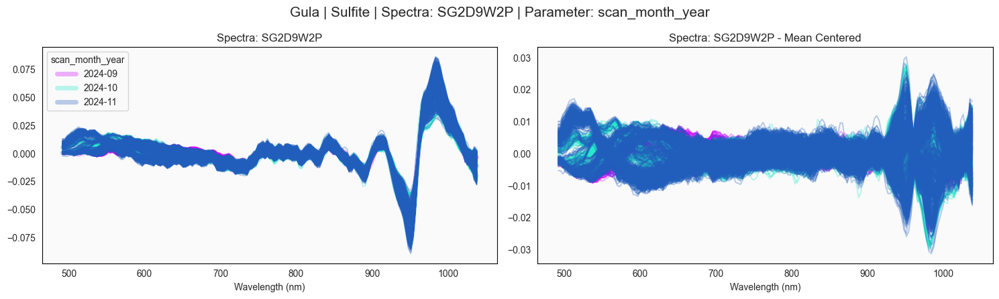

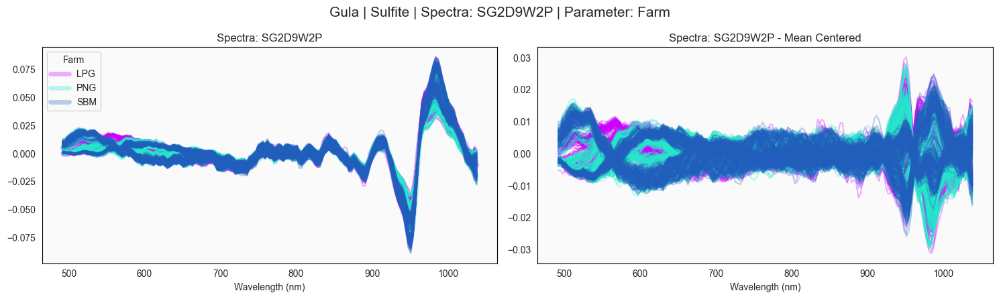

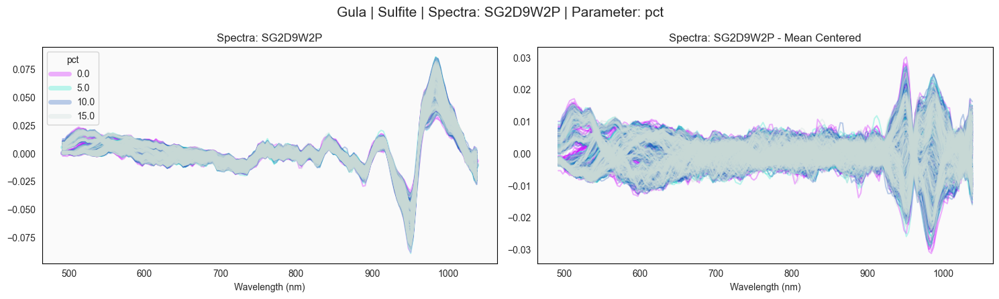

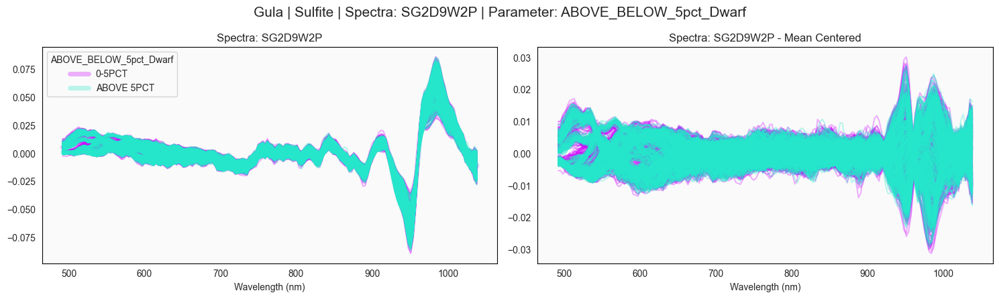

In [ ]:
for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'
    
    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')

    msc = SavitzkyGolay(deriv=2, window=9, polyorder=2)
    msc_df = pd.DataFrame(msc.fit_transform(selected_df), 
                        columns=selected_df.columns[4:-4], index=selected_df.index)
    plot_df = msc_df.copy()

    spectra_meta = {
        **spectra_meta,
        f'{selection}_plot_df' : plot_df
    }

    for param, label_type in param_label_map.items():
        plot_spectra(plot_df, labels=selected_labels[[param]],
                    label_type=label_type,
                    spec_prep=PREPROCESSING,
                    sample_type=SAMPLE_TYPE,
                    cmap=cmap)

Total Explained Variance: 95.644% 
    Number of Components: 7


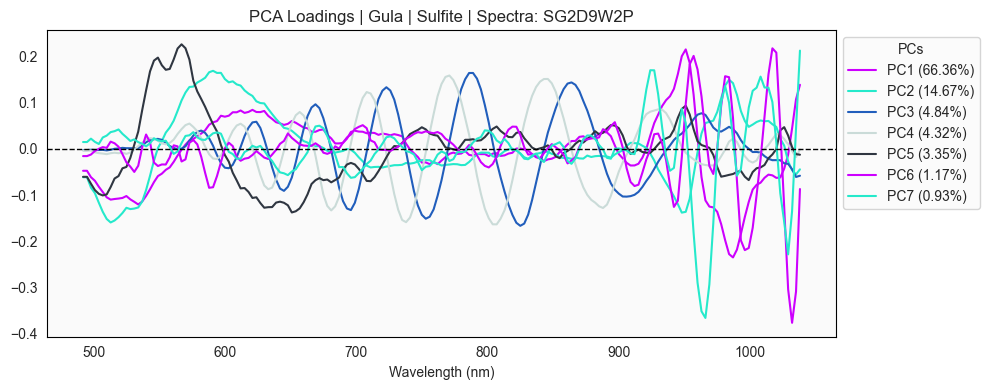

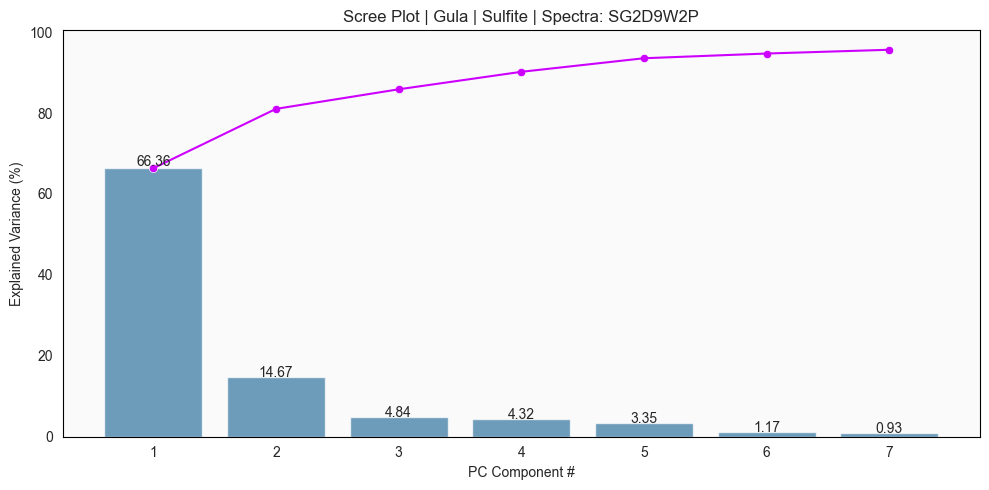

In [ ]:
N_COMP = 0.95
RANDOM_STATE = 42

for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'

    plot_df = spectra_meta[f'{selection}_plot_df']

    fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)

    spectra_meta = {
        **spectra_meta,
        f'{selection}_fitted_pc' : fitted_pc,
        f'{selection}_pc_labels' : pc_labels,
        }

    fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
                            spec_prep=PREPROCESSING, 
                            sample_type=SAMPLE_TYPE)
    fig1, ax1 = plot_scree(fitted_pc,
                        spec_prep=PREPROCESSING, 
                        sample_type=SAMPLE_TYPE)
    print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
    Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

Assigned Sulfite_spectra to spectra_df
Assigned Sulfite_label to label_df


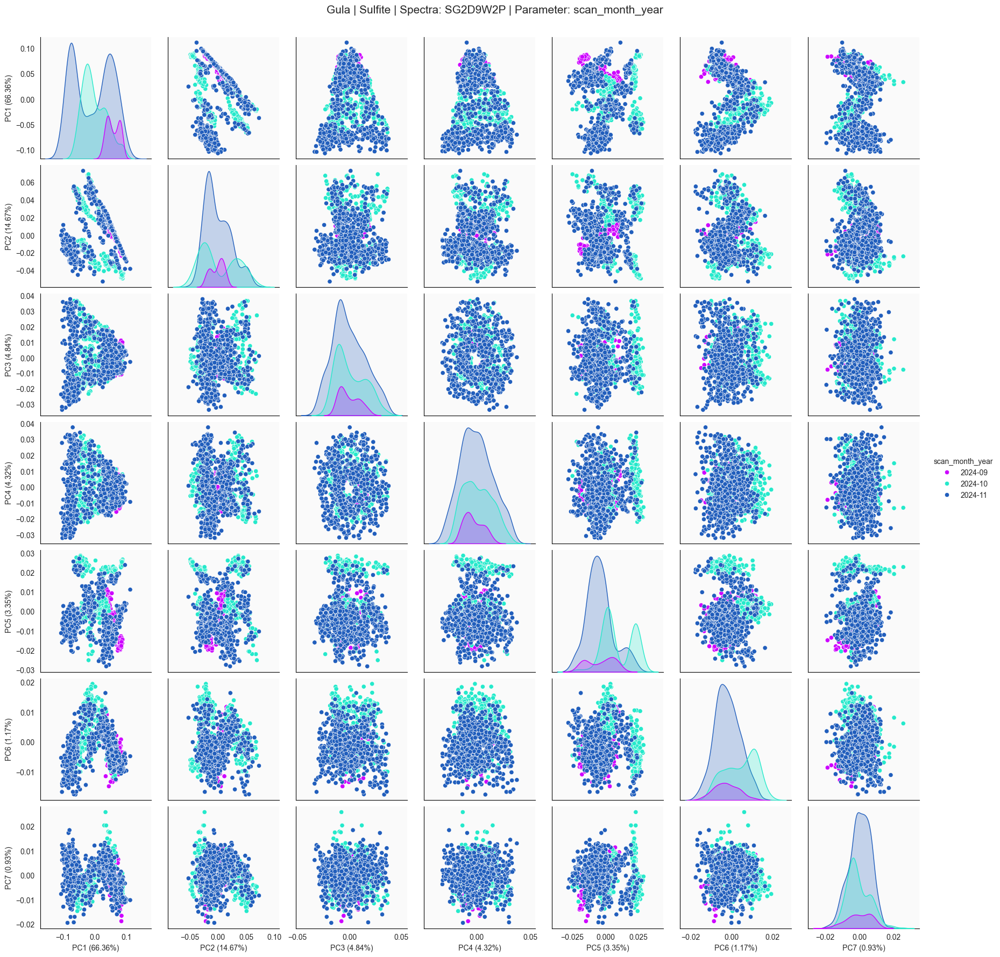

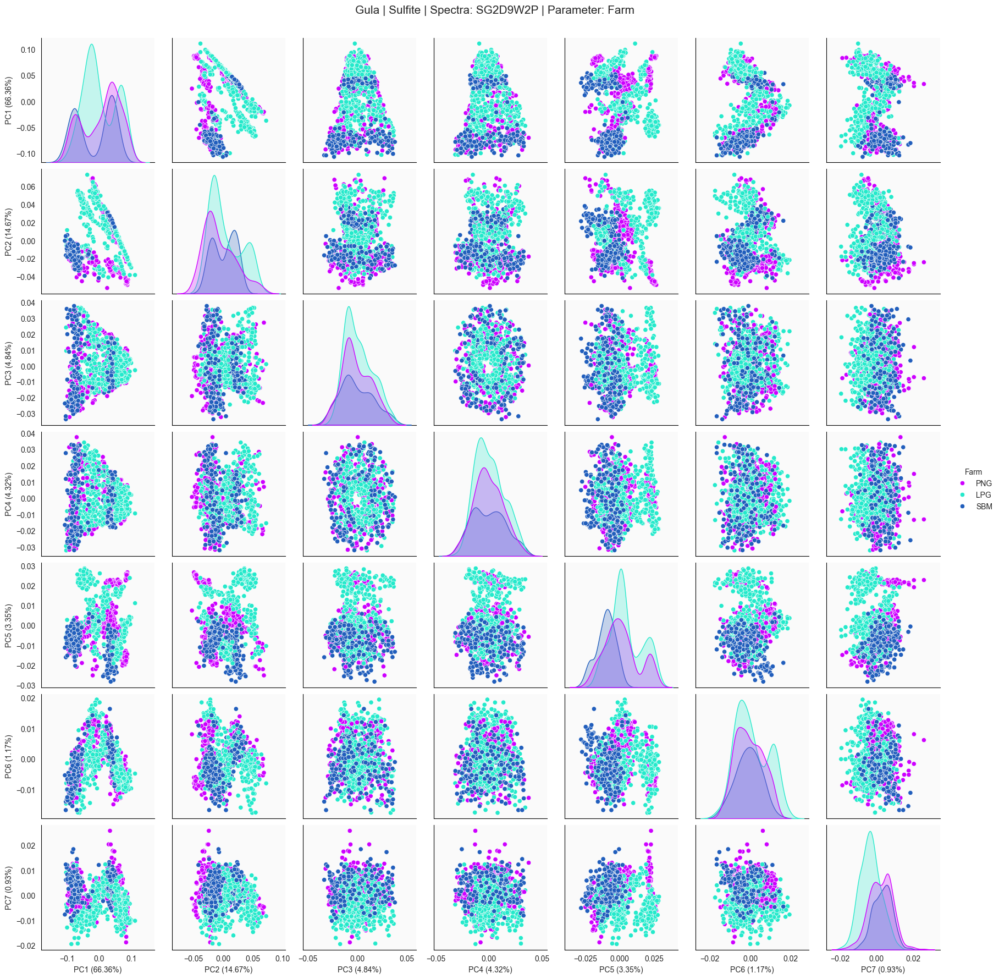

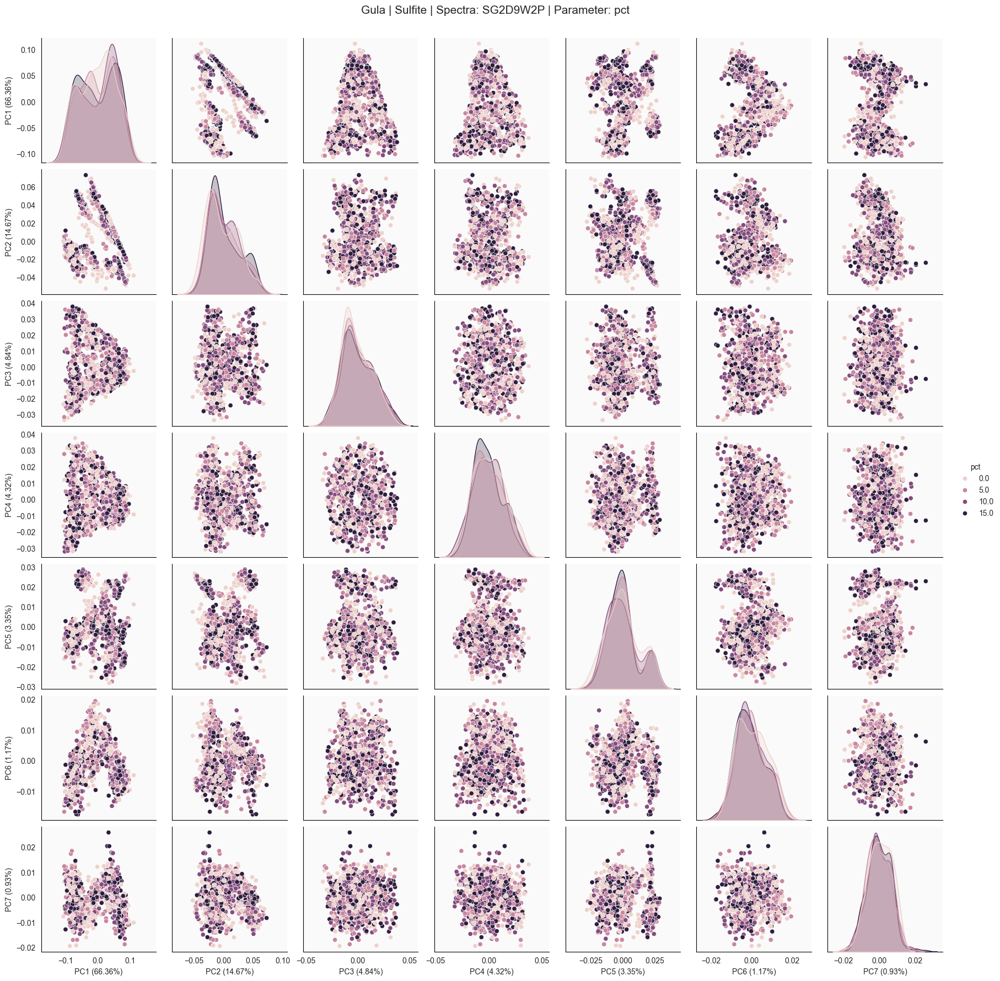

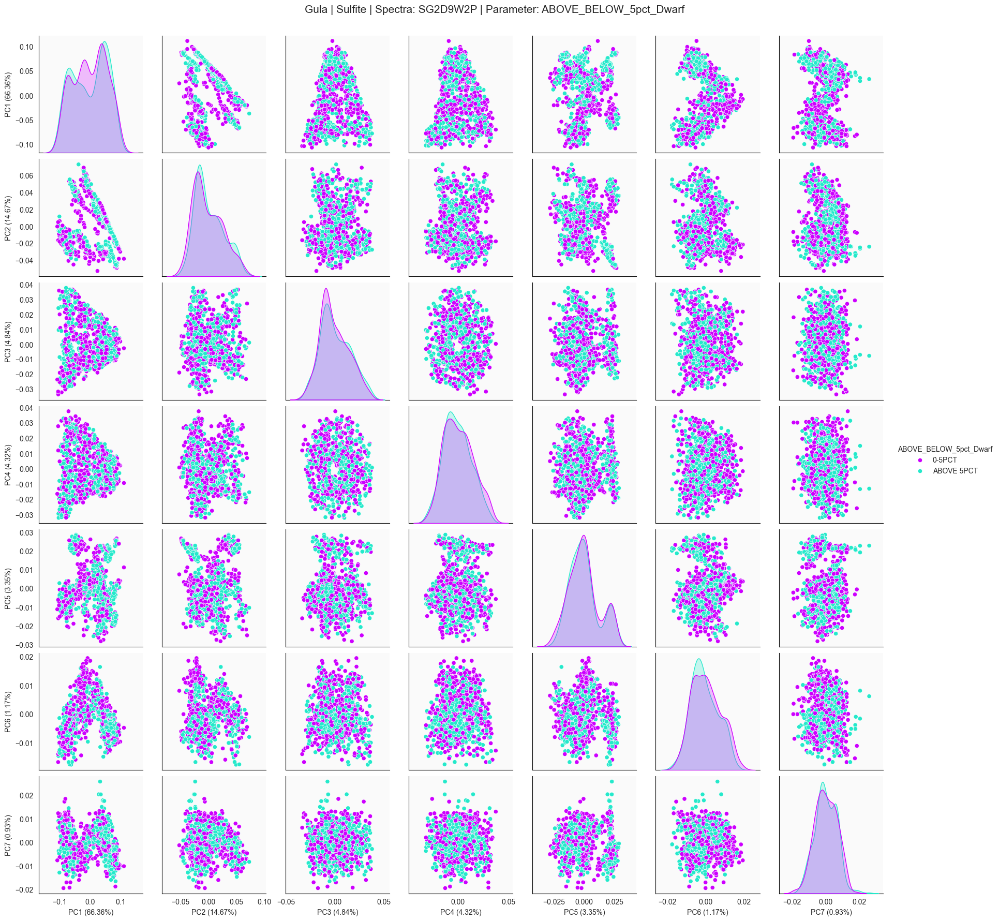

In [ ]:
for selection in selections:
    SAMPLE_TYPE = f'Gula | {selection}'

    for split in data_split:
        key = f'{selection}_{split}'
        if key in cleaned_spectra:
            if split == 'spectra':
                selected_df = cleaned_spectra[key]
            elif split == 'label':
                selected_labels = cleaned_spectra[key]
            print(f'Assigned {key} to {split}_df')
    
    plot_df = spectra_meta[f'{selection}_plot_df']
    fitted_pc = spectra_meta[f'{selection}_fitted_pc']
    pc_labels = spectra_meta[f'{selection}_pc_labels']

    for param in param_label_map.keys():
        pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=selected_labels[[param]])
        sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
        plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [ ]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()

# SNV-SG2D9W2P

In [ ]:
# # CONFIGS
# msc = SavitzkyGolay(deriv=2, window=9, polyorder=2)
# msc_df = pd.DataFrame(msc.fit_transform(SNV().fit_transform(raw_df)), 
#                       columns=raw_df.columns[4:-4], index=raw_df.index)
# plot_df = msc_df.copy()
# PREPROCESSING = 'SNV-SG2D9W2P'

In [ ]:
# for param, label_type in param_label_map.items():
#     plot_spectra(plot_df, labels=label_df[[param]],
#                  label_type=label_type,
#                  spec_prep=PREPROCESSING,
#                  sample_type=SAMPLE_TYPE,
#                  cmap=cmap)

In [ ]:
# N_COMP = 0.93
# RANDOM_STATE = 42

# fitted_pc, pc_labels = fit_pca(plot_df, N_COMP, RANDOM_STATE)
# fig2, ax2 = plot_loadings(plot_df, fitted_pc, pc_labels, 
#                           spec_prep=PREPROCESSING, 
#                           sample_type=SAMPLE_TYPE)
# fig1, ax1 = plot_scree(fitted_pc,
#                        spec_prep=PREPROCESSING, 
#                        sample_type=SAMPLE_TYPE)
# print(f"""Total Explained Variance: {fitted_pc.explained_variance_ratio_.sum()*100:.3f}% 
# Number of Components: {len(fitted_pc.explained_variance_ratio_)}""")

In [ ]:
# for param in param_label_map.keys():
#     pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df[[param]])
#     sns.pairplot(data=pc_df.reset_index().drop('lot_id', axis=1), hue=param)
#     plt.suptitle(f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING} | Parameter: {param}', y=1.02, size=15)

In [ ]:
# fig = make_subplots(rows=3, cols= 2, 
#                     subplot_titles=['F Test Spectra', 'F Test PCA', 
#                                     'Mutual Info Spectra', 'Mutual Info PCA',
#                                     'Chi2 Spectra', 'Chi2 PCA'],
#                     specs=[[{'secondary_y': True}, {'secondary_y': True}],
#                            [{'secondary_y': False}, {'secondary_y': False}],
#                            [{'secondary_y': True}, {'secondary_y': True}]],
#                     horizontal_spacing=0.15,
#                     vertical_spacing=0.1)

# title = f'{SAMPLE_TYPE} | Spectra: {PREPROCESSING}'
# colors = px.colors.qualitative.Plotly
# pc_df = generate_pc_df(plot_df, fitted_pc, pc_labels, labels=label_df)
# n_comp = fitted_pc.n_components_

# for i, param in enumerate(param_label_map.keys()):
#     try:
#         f_reg_spec = f_classif(plot_df, label_df[param].values.ravel())
#         f_reg_pca = f_classif(pc_df.iloc[:, :n_comp], pc_df[param].values.ravel())
#         mms = MinMaxScaler()
#         scaled_spec = mms.fit_transform(plot_df)
#         scaled_pca = mms.fit_transform(pc_df.iloc[:, :n_comp])
#         mi_spec = mutual_info_classif(scaled_spec, label_df[param].values.ravel())
#         mi_pca = mutual_info_classif(scaled_pca, pc_df[param].values.ravel())
#         chi2_spec = chi2(scaled_spec, label_df[param].values.ravel())
#         chi2_pca = chi2(scaled_pca, pc_df[param].values.ravel())
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=f_reg_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=1, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=f_reg_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=1, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=mi_spec, marker_color=colors[i], name=param,
#                        opacity=0.8, showlegend=False),
#                        secondary_y=False,row=2, col=1)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=mi_pca, name=param, marker_color=colors[i],
#                        showlegend=False, opacity=0.8),
#                     secondary_y=False, row=2, col=2)
        
#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=1)

#         fig.add_trace(
#             go.Scatter(x=plot_df.columns, y=chi2_spec[1], name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=1)
        
#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[0], marker_color=colors[i], name=param,
#                        opacity=0.5, showlegend=False),
#                        secondary_y=False,row=3, col=2)

#         fig.add_trace(
#             go.Scatter(x=pc_df.columns[:n_comp], y=chi2_pca[1], showlegend=False,
#                        name=param, marker_color=colors[i]),
#                     secondary_y=True, row=3, col=2)
        
#     except:
#         pass

# # Add figure title
# fig.update_layout(title_text=title, height=1400, width=1400)
# fig.update_xaxes(title_text="Wavelengths (nm)", col=1)
# fig.update_xaxes(title_text="No. of PCs", col=2)

# # Set y-axes titles
# fig.update_yaxes(title_text="F value", secondary_y=False, row=1)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=1)
# fig.update_yaxes(title_text="Mutual Information", secondary_y=False, row=2)
# fig.update_yaxes(title_text="Chi2", secondary_y=False, row=3)
# fig.update_yaxes(title_text="p value", secondary_y=True, row=3)

# fig.show()